### 导入相关库

In [2]:
# Importing the basic libraries.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import pandas_profiling as pdb
import os
plt.style.use('seaborn-darkgrid')

In [3]:
# Loading the data. 查看当前目录下的文件
print(os.listdir('./'))

['.ipynb_checkpoints', 'Churn Management.ipynb', 'churn_test.txt', 'churn_training.txt', 'Image', 'logistic_regression.ipynb', 'neural_networks.ipynb', 'svm.ipynb']


### 导入数据

In [4]:
train_data = pd.read_csv('churn_training.txt', sep='\t')
test_data = pd.read_csv('churn_test.txt', sep='\t')

In [5]:
# checking the training and testing data.
print(train_data.shape)
print(test_data.shape)

(2000, 21)
(1033, 21)


In [6]:
# 去除没有用处的特征
train_data.drop('area_code', axis=1, inplace=True)
test_data.drop('area_code', axis=1, inplace=True)
train_data.drop('phone_number', axis=1, inplace=True)
test_data.drop('phone_number', axis=1, inplace=True)
train_data.drop('state', axis=1, inplace=True)
test_data.drop('state', axis=1, inplace=True)

In [7]:
# checking the training and testing data.
print(train_data.shape)
print(test_data.shape)

(2000, 18)
(1033, 18)


### 数据探索

In [7]:
# checking the sample data for training data.
train_data.head(20)

,account_length,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,class
0,128,0,1,25,265.1,110,45.07,197.4,99,16.78,244.7,91,11.01,10.0,3,2.70,1,0
1,84,1,0,0,299.4,71,50.90,61.9,88,5.26,196.9,89,8.86,6.6,7,1.78,2,0
2,75,1,0,0,166.7,113,28.34,148.3,122,12.61,186.9,121,8.41,10.1,3,2.73,3,0
3,118,1,0,0,223.4,98,37.98,220.6,101,18.75,203.9,118,9.18,6.3,6,1.70,0,0
4,117,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,0
5,141,1,1,37,258.6,84,43.96,222.0,111,18.87,326.4,97,14.69,11.2,5,3.02,0,0
6,74,0,0,0,187.7,127,31.91,163.4,148,13.89,196.0,94,8.82,9.1,5,2.46,0,0
7,85,0,1,27,196.4,139,33.39,280.9,90,23.88,89.3,75,4.02,13.8,4,3.73,1,0
8,93,0,0,0,190.7,114,32.42,218.2,111,18.55,129.6,121,5.83,8.1,3,2.19,3,0
9,76,0,1,33,189.7,66,32.25,212.8,65,18.09,165.7,108,7.46,10.0,5,2.70,1,0


In [8]:
# for each columns, let's quickly look into the distinct values as well.
# this is one of the ways in which we can understand any gaps in the data model.
for each_col in train_data.columns:
    print(each_col)
    print(train_data[each_col].value_counts())
    print("")

account_length
93     28
105    27
112    26
87     26
119    25
       ..
9       1
188     1
186     1
5       1
2       1
Name: account_length, Length: 201, dtype: int64

international_plan
0    1787
1     213
Name: international_plan, dtype: int64

voice_mail_plan
0    1439
1     561
Name: voice_mail_plan, dtype: int64

number_vmail_messages
0     1439
31      38
33      32
29      31
28      30
27      29
26      27
30      27
35      26
32      23
24      23
23      20
34      19
37      18
36      18
22      18
25      17
39      17
38      15
20      15
21      15
16      12
19      11
40       9
17       9
42       8
12       6
15       6
41       6
43       6
44       4
45       4
46       3
18       3
14       3
47       3
13       3
48       2
49       1
4        1
8        1
11       1
9        1
Name: number_vmail_messages, dtype: int64

total_day_minutes
174.5    7
154.0    6
159.5    6
227.4    6
197.2    5
        ..
181.6    1
78.6     1
299.4    1
254.3    1
234.4   

In [9]:
# checking basic statistics of training data.  统计数据
train_data.describe()

,account_length,international_plan,voice_mail_plan,number_vmail_messages,total_day_minutes,total_day_calls,total_day_charge,total_eve_minutes,total_eve_calls,total_eve_charge,total_night_minutes,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,total_intl_charge,number_customer_service_calls,class
count,2000.00000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,100.44550,0.106500,0.280500,8.209000,178.652850,100.456500,30.371530,201.650750,100.066000,17.140485,200.461300,99.957000,9.020830,10.224950,4.477000,2.761180,1.577500,0.145000
std,39.55121,0.308554,0.449356,13.755433,54.369621,20.375271,9.242837,50.608857,20.030383,4.301777,50.086001,19.459792,2.253906,2.758149,2.487482,0.744709,1.321691,0.352189
min,1.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,23.200000,33.000000,1.040000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,73.00000,0.000000,0.000000,0.000000,142.975000,87.000000,24.305000,167.400000,87.000000,14.230000,167.275000,87.000000,7.527500,8.500000,3.000000,2.300000,1.000000,0.000000
50%,100.00000,0.000000,0.000000,0.000000,178.150000,101.000000,30.285000,202.350000,100.000000,17.200000,201.600000,100.000000,9.070000,10.300000,4.000000,2.780000,1.000000,0.000000
75%,126.00000,0.000000,1.000000,20.000000,216.000000,114.000000,36.720000,235.500000,113.000000,20.020000,233.725000,113.000000,10.520000,12.000000,6.000000,3.240000,2.000000,0.000000
max,232.00000,1.000000,1.000000,49.000000,346.800000,165.000000,58.960000,361.800000,168.000000,30.750000,381.900000,175.000000,17.190000,18.300000,20.000000,4.940000,9.000000,1.000000


In [10]:
# Checking the information about the data. 查看非缺失值总数
# this will tell us how many and what type of columns/rows we have in the data.
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 18 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   account_length                 2000 non-null   int64  
 1   international_plan             2000 non-null   int64  
 2   voice_mail_plan                2000 non-null   int64  
 3   number_vmail_messages          2000 non-null   int64  
 4   total_day_minutes              2000 non-null   float64
 5   total_day_calls                2000 non-null   int64  
 6   total_day_charge               2000 non-null   float64
 7   total_eve_minutes              2000 non-null   float64
 8   total_eve_calls                2000 non-null   int64  
 9   total_eve_charge               2000 non-null   float64
 10  total_night_minutes            2000 non-null   float64
 11  total_night_calls              2000 non-null   int64  
 12  total_night_charge             2000 non-null   f

In [11]:
# Creating a list of columns which are numeric.
numeric_cols = list(train_data.select_dtypes(exclude='object').columns)
numeric_cols

['account_length',
 'international_plan',
 'voice_mail_plan',
 'number_vmail_messages',
 'total_day_minutes',
 'total_day_calls',
 'total_day_charge',
 'total_eve_minutes',
 'total_eve_calls',
 'total_eve_charge',
 'total_night_minutes',
 'total_night_calls',
 'total_night_charge',
 'total_intl_minutes',
 'total_intl_calls',
 'total_intl_charge',
 'number_customer_service_calls',
 'class']

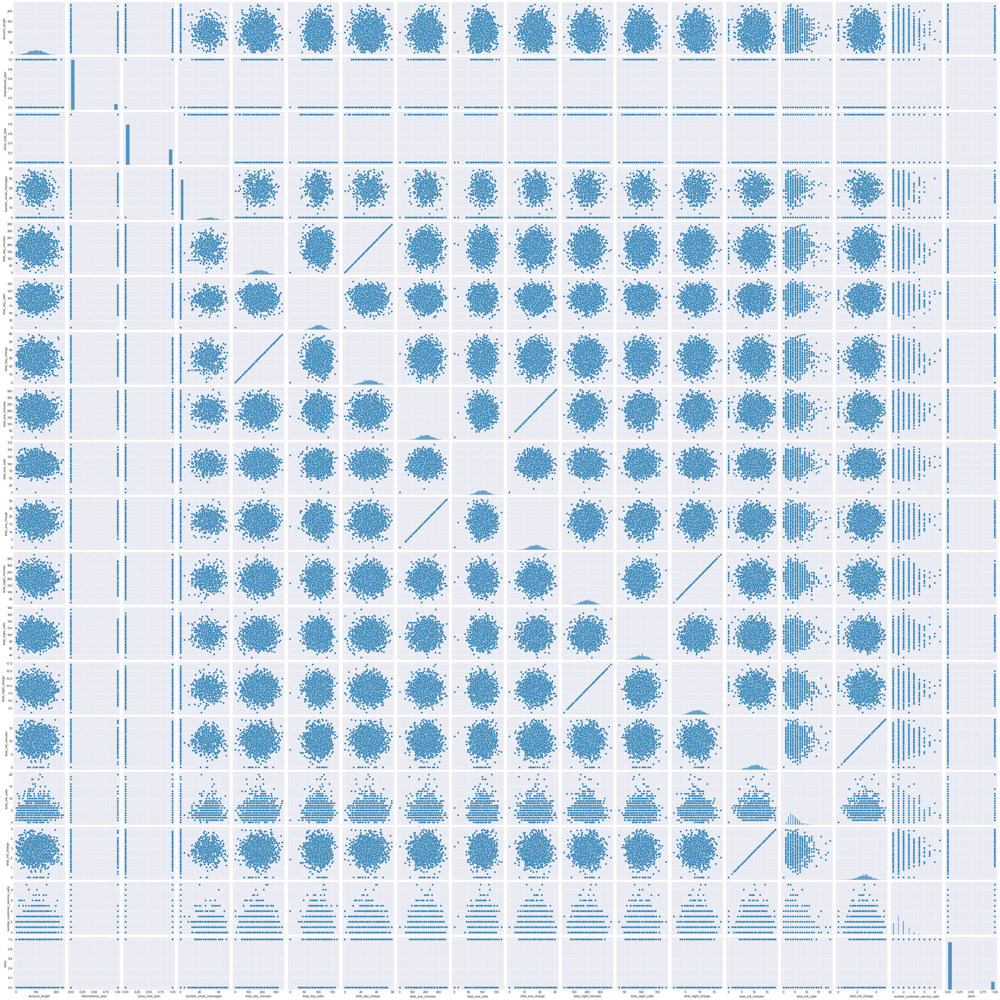

In [12]:
# For each numerical column, let's check the data distribution.  查看数据分布
# for this we are using seaborn library and try performing pairplotting
sns.pairplot(train_data[numeric_cols])
plt.show()

In [13]:
# using pandas profiler once to look into all the data columns. 
train_data_profile = pdb.ProfileReport(train_data)
train_data_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [14]:
# using pandas profiler once to look into all the data columns. 
test_data_profile = pdb.ProfileReport(test_data)
test_data_profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

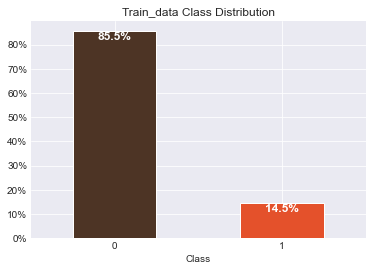

In [8]:
import matplotlib.ticker as mtick # For specifying the axes tick format 
colors = ['#4D3425','#E4512B']
ax = (train_data['class'].value_counts()*100.0 /len(train_data)).plot(kind='bar',
                                                                           stacked = True,
                                                                          rot = 0,
                                                                          color = colors)
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
# ax.set_ylabel('% ')
ax.set_xlabel('Class')
# ax.set_ylabel('% ')
ax.set_title('Train_data Class Distribution')

# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)

for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_x()+.15, i.get_height()-3.5, \
            str(round((i.get_height()/total), 1))+'%',
            fontsize=12,
            color='white',
           weight = 'bold')

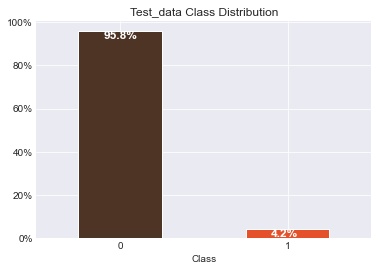

In [16]:
import matplotlib.ticker as mtick # For specifying the axes tick format 
colors = ['#4D3425','#E4512B']
ax = (test_data['class'].value_counts()*100.0 /len(test_data)).plot(kind='bar',
                                                                           stacked = True,
                                                                          rot = 0,
                                                                          color = colors)
ax.yaxis.set_major_formatter(mtick.PercentFormatter())
# ax.set_ylabel('% ')
ax.set_xlabel('Class')
# ax.set_ylabel('% ')
ax.set_title('Test_data Class Distribution')

# create a list to collect the plt.patches data
totals = []

# find the values and append to list
for i in ax.patches:
    totals.append(i.get_width())

# set individual bar lables using above list
total = sum(totals)

for i in ax.patches:
    # get_width pulls left or right; get_y pushes up or down
    ax.text(i.get_x()+.15, i.get_height()-3.5, \
            str(round((i.get_height()/total), 1))+'%',
            fontsize=12,
            color='white',
           weight = 'bold')

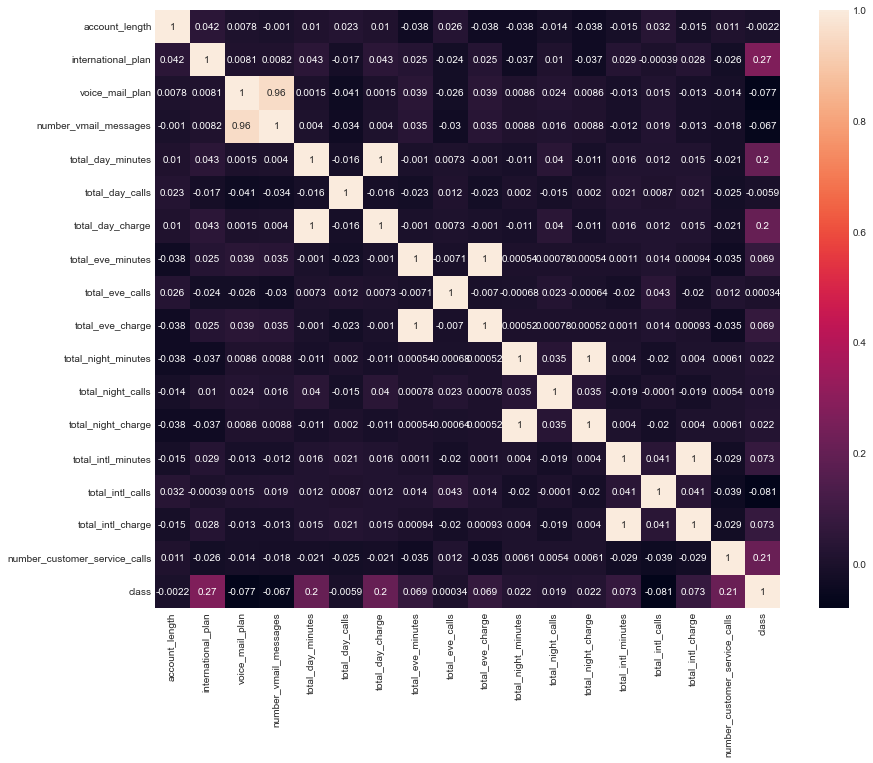

In [17]:
# creating heatmap
plt.figure(figsize=(14,11))
sns.heatmap(train_data.corr(), annot=True)
plt.show()

## 剔除异常值

In [9]:
def zscore(df):
    out = []
    m = np.mean(df)
    sd = np.std(df)
    for i in enumerate(df):
        n = i[0]
        i = i[1]
        z = (i-m) / sd
        if np.abs(z) > 3:
            out.append(n)
#             print(i)
#     print("Outliers:", out)
    return len(out), out

In [10]:
numeric_cols = list(train_data.select_dtypes(exclude='object').columns)
print(len(numeric_cols))

numeric_cols = numeric_cols[:-1]
print(numeric_cols)
print(len(numeric_cols))


18
['account_length', 'international_plan', 'voice_mail_plan', 'number_vmail_messages', 'total_day_minutes', 'total_day_calls', 'total_day_charge', 'total_eve_minutes', 'total_eve_calls', 'total_eve_charge', 'total_night_minutes', 'total_night_calls', 'total_night_charge', 'total_intl_minutes', 'total_intl_calls', 'total_intl_charge', 'number_customer_service_calls']
17


In [11]:
num_dele, dele = 0, []
for i in numeric_cols:
    i = str(i)
    t1,t2 = zscore(train_data[i])
    num_dele += t1
    dele.extend(t2)
    
dele = list(set(dele))
print(len(dele), dele)

99 [514, 517, 12, 529, 1554, 1043, 532, 542, 1575, 1596, 572, 574, 590, 593, 1626, 100, 613, 1126, 102, 105, 1643, 1645, 1655, 1143, 1148, 641, 1172, 666, 1185, 1188, 1702, 679, 680, 169, 1192, 188, 191, 197, 1745, 1752, 217, 1762, 1763, 1766, 1771, 751, 1777, 243, 758, 1806, 784, 275, 790, 279, 283, 795, 802, 1826, 293, 1835, 302, 1326, 1842, 307, 836, 1862, 1865, 844, 336, 1365, 358, 362, 366, 1397, 888, 1401, 1404, 1925, 399, 1936, 1426, 919, 410, 1438, 928, 416, 930, 1966, 1976, 1977, 443, 1470, 453, 970, 480, 490, 499, 1529, 508]


### 法二 鲁棒性z_score

In [21]:
import scipy.stats as stats

def robust_zscore(df):
    out = []
    med = np.median(df)
    ma = stats.median_absolute_deviation(df)
    for i in enumerate(df):
        n = i[0]
        i = i[1]
        z = (0.6745*(i-med)) / (np.median(ma))
        if np.abs(z) > 3:
            out.append(n)
#             print(i)
#     print("Outliers:", out)
    return out

In [22]:
# num_dele, dele = 0, []
# for i in numeric_cols:
#     i = str(i)
#     t1 = robust_zscore(train_data[i])
#     dele.extend(t1)
    
# dele = list(set(dele))
# print(len(dele), dele)

### Basic model

In [12]:
#importing all the required ML packages
from sklearn.linear_model import LogisticRegression #logistic regression
from sklearn import svm #support vector Machine
from sklearn.ensemble import RandomForestClassifier #Random Forest
from sklearn.neighbors import KNeighborsClassifier #KNN
from sklearn.naive_bayes import GaussianNB #Naive bayes
from sklearn.tree import DecisionTreeClassifier #Decision Tree
from sklearn import tree
from sklearn.model_selection import train_test_split #training and testing data split
from sklearn import metrics #accuracy measure
from sklearn.metrics import confusion_matrix #for confusion matrix

In [13]:
DTC = DecisionTreeClassifier()

# 划分数据、标签
train_x, test_x = train_data.drop(columns='class', axis=1), test_data.drop(columns='class', axis=1)
train_y, test_y = train_data['class'], test_data['class']
print(train_x.shape, train_y.shape)

def DTC_model(train_x, train_y, test_x, test_y):
    DTC.fit(train_x, train_y)
    prediction = DTC.predict(test_x)
    print('The accuracy of the Decision Tree is',metrics.accuracy_score(prediction, test_y))
    print('The f1_score of the Decision Tree is',metrics.f1_score(prediction, test_y))
    print('The precision_score of the Decision Tree is',metrics.precision_score(prediction, test_y))
    print('The recall_score of the Decision Tree is',metrics.recall_score(prediction, test_y))
    print('The roc_auc_score of the Decision Tree is',metrics.roc_auc_score(prediction, test_y))
    print(confusion_matrix(test_y, prediction))

DTC_model(train_x, train_y, test_x, test_y)

(2000, 17) (2000,)
The accuracy of the Decision Tree is 0.9370764762826719
The f1_score of the Decision Tree is 0.4881889763779528
The precision_score of the Decision Tree is 0.7209302325581395
The recall_score of the Decision Tree is 0.36904761904761907
The roc_auc_score of the Decision Tree is 0.6782013648452005
[[937  53]
 [ 12  31]]


### 数据归一化处理

In [48]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler, Normalizer

sclaer = MinMaxScaler()
train_x1, test_x1 = sclaer.fit_transform(train_x), sclaer.fit_transform(test_x)
DTC_model(train_x1, train_y, test_x1, test_y)

The accuracy of the Decision Tree is 0.8402710551790901
The f1_score of the Decision Tree is 0.2794759825327511
The precision_score of the Decision Tree is 0.7441860465116279
The recall_score of the Decision Tree is 0.17204301075268819
The roc_auc_score of the Decision Tree is 0.5795279988828376
[[836 154]
 [ 11  32]]


In [49]:
sclaer = StandardScaler()
train_x2, test_x2 = sclaer.fit_transform(train_x), sclaer.fit_transform(test_x)
DTC_model(train_x2, train_y, test_x2, test_y)

The accuracy of the Decision Tree is 0.9332042594385286
The f1_score of the Decision Tree is 0.5035971223021583
The precision_score of the Decision Tree is 0.813953488372093
The recall_score of the Decision Tree is 0.3645833333333333
The roc_auc_score of the Decision Tree is 0.6780227232301671
[[929  61]
 [  8  35]]


In [27]:
sclaer = Normalizer()
train_x3, test_x3 = sclaer.fit_transform(train_x), sclaer.fit_transform(test_x)
DTC_model(train_x3, train_y, test_x3, test_y)

The accuracy of the Decision Tree is 0.882865440464666
The f1_score of the Decision Tree is 0.2576687116564417
The precision_score of the Decision Tree is 0.4883720930232558
The recall_score of the Decision Tree is 0.175
The roc_auc_score of the Decision Tree is 0.5754518072289156
[[891  99]
 [ 22  21]]


### 欠采样

In [28]:
from imblearn.under_sampling import RandomUnderSampler

count_train_class_one = train_y.sum()
print(train_y.shape)
print('标签为1的样本数:{}'.format(count_train_class_one))

# 减少标签0，使标签1占总数的10%
under = RandomUnderSampler(random_state=42)
x_train_under, y_train_under = under.fit_resample(train_x, train_y)

print(y_train_under.shape)
count_train_class_one = y_train_under.sum()
print('标签为1的样本数:{}'.format(count_train_class_one))


(2000,)
标签为1的样本数:290
(580,)
标签为1的样本数:290


In [29]:
DTC_model(x_train_under, y_train_under, test_x, test_y)

The accuracy of the Decision Tree is 0.8121974830590513
The f1_score of the Decision Tree is 0.26515151515151514
The precision_score of the Decision Tree is 0.813953488372093
The recall_score of the Decision Tree is 0.1583710407239819
The roc_auc_score of the Decision Tree is 0.5742594119876067
[[804 186]
 [  8  35]]


### 过采样

In [30]:
from imblearn.over_sampling import SMOTE


count_train_class_one = train_y.sum()
print(train_y.shape)
print('类别1数量:{}'.format(count_train_class_one))

# Class 0：增加class 1直到class 1=9:1
smote = SMOTE(sampling_strategy = 0.5, random_state=100)
x_train_smote, y_train_smote = smote.fit_resample(train_x, train_y)

print(train_y.shape)
print("类别1数量:{}".format(y_train_smote.sum()) )

(2000,)
类别1数量:290
(2000,)
类别1数量:855


In [31]:
DTC_model(x_train_smote, y_train_smote, test_x, test_y)

The accuracy of the Decision Tree is 0.904162633107454
The f1_score of the Decision Tree is 0.3694267515923567
The precision_score of the Decision Tree is 0.6744186046511628
The recall_score of the Decision Tree is 0.2543859649122807
The roc_auc_score of the Decision Tree is 0.6195760074833438
[[905  85]
 [ 14  29]]


在此之前的决策树模型是基于Gini算法的，下面将使用entropy算法构造决策树。

In [19]:
def Result(prediction, test_y):
    print('The accuracy of the Decision Tree is',metrics.accuracy_score(prediction, test_y))
    print('The f1_score of the Decision Tree is',metrics.f1_score(prediction, test_y))
    print('The precision_score of the Decision Tree is',metrics.precision_score(prediction, test_y))
    print('The recall_score of the Decision Tree is',metrics.recall_score(prediction, test_y))
    print('The roc_auc_score of the Decision Tree is',metrics.roc_auc_score(prediction, test_y))
    print(confusion_matrix(test_y, prediction))

DTC1 = DecisionTreeClassifier(criterion='entropy')
DTC1.fit(train_x, train_y)
prediction = DTC1.predict(test_x)
Result(prediction, test_y)

The accuracy of the Decision Tree is 0.952565343659245
The f1_score of the Decision Tree is 0.5663716814159292
The precision_score of the Decision Tree is 0.7441860465116279
The recall_score of the Decision Tree is 0.45714285714285713
The roc_auc_score of the Decision Tree is 0.7228601097759976
[[952  38]
 [ 11  32]]


对比基于Gini与基于Entropy构建决策树的结果，结合各项指标，可以确定基于Entropy算法构建决策树结果更优。下面将以Entropy为基准，优化决策树模型。

In [33]:
from sklearn import tree

# 根据数据归一化部分的实验可知，选择均值归一化效果最佳
sclaer = StandardScaler()
train_x4, test_x4 = sclaer.fit_transform(train_x), sclaer.fit_transform(test_x)
clf = DTC1.fit(train_x4, train_y)
prediction = DTC1.predict(test_x4)
Result(prediction, test_y)

# tree.plot_tree(clf)

The accuracy of the Decision Tree is 0.9467570183930301
The f1_score of the Decision Tree is 0.5599999999999999
The precision_score of the Decision Tree is 0.813953488372093
The recall_score of the Decision Tree is 0.4268292682926829
The roc_auc_score of the Decision Tree is 0.7092085353030186
[[943  47]
 [  8  35]]


## 优化决策树模型

### Pre-pruning
Pre pruning is nothing but stoping the growth of decision tree on an early stage. For that we can limit the growth of trees by setting constrains. We can limit parameters like max_depth , min_samples etc.

An effective way to do is that we can grid search those parameters and choose the optimum values that gives better performace on test data.

In [34]:
import numpy as np
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.metrics import accuracy_score,confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

params = {'max_depth': [2,4,6,8,10,12],
         'min_samples_split': [2,3,4],
         'min_samples_leaf': [1,2]}

DTC1 = DecisionTreeClassifier(criterion='entropy')
gcv = GridSearchCV(estimator=DTC1, param_grid=params)
gcv.fit(train_x4, train_y)


GridSearchCV(estimator=DecisionTreeClassifier(criterion='entropy'),
             param_grid={'max_depth': [2, 4, 6, 8, 10, 12],
                         'min_samples_leaf': [1, 2],
                         'min_samples_split': [2, 3, 4]})

In [35]:
model = gcv.best_estimator_
model.fit(train_x4, train_y)
y_test_pred = model.predict(test_x4)

Result(y_test_pred, test_y)

The accuracy of the Decision Tree is 0.9757986447241046
The f1_score of the Decision Tree is 0.7191011235955057
The precision_score of the Decision Tree is 0.7441860465116279
The recall_score of the Decision Tree is 0.6956521739130435
The roc_auc_score of the Decision Tree is 0.8422536452138671
[[976  14]
 [ 11  32]]


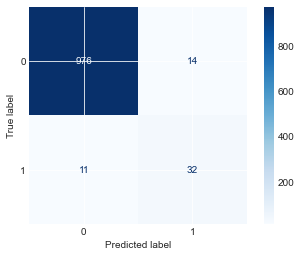

In [36]:
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt

plot_confusion_matrix(model, test_x4, test_y, cmap="Blues")
plt.savefig('./Image/decision_tree_cm.jpg', dpi=200)
plt.show()

### Post pruning
There are several post pruning techniques. Cost complexity pruning is one of the important among them.

Cost Complexity Pruning
Decision trees can easily overfit. One way to avoid it is to limit the growth of trees by setting constrains. We can limit parameters like max_depth , min_samples etc. But a most effective way is to use post pruning methods like cost complexity pruning. This helps to improve test accuracy and get a better model.

Cost complexity pruning is all about finding the right parameter for alpha.We will get the alpha values for this tree and will check the accuracy with the pruned trees.

In [37]:
path = DTC1.cost_complexity_pruning_path(train_x4, train_y)
ccp_alphas, impurities = path.ccp_alphas, path.impurities
print(ccp_alphas)

[0.         0.001      0.001      0.001      0.00114943 0.00114943
 0.00120113 0.00126466 0.00137744 0.00137744 0.00137744 0.00137744
 0.00137744 0.00137744 0.00137744 0.00141937 0.00159861 0.00162256
 0.00162256 0.00162256 0.00162256 0.00180482 0.00186767 0.00186767
 0.00190098 0.00193133 0.00200431 0.00206148 0.00207299 0.00217426
 0.00217426 0.0022322  0.00224824 0.0022846  0.00230594 0.00231048
 0.00242738 0.00242738 0.00250978 0.00255365 0.00255379 0.00260433
 0.00272512 0.00282599 0.00290005 0.00294492 0.00303331 0.0031218
 0.00315437 0.00318668 0.00352419 0.00363086 0.00376221 0.00389362
 0.00391106 0.00461334 0.00478723 0.00480168 0.00543266 0.00543912
 0.0060613  0.00685766 0.00724071 0.01239509 0.01244109 0.01723725
 0.02132355 0.02339192 0.03518265 0.05114347 0.05747855]


In [38]:
# For each alpha we will append our model to a list
clfs = []
for ccp_alpha in ccp_alphas:
    clf = tree.DecisionTreeClassifier(criterion='entropy' ,random_state=0, ccp_alpha=ccp_alpha)
    clf.fit(train_x4, train_y)
    clfs.append(clf)

We will remove the last element in clfs and ccp_alphas, because it is the trivial tree with only one node.

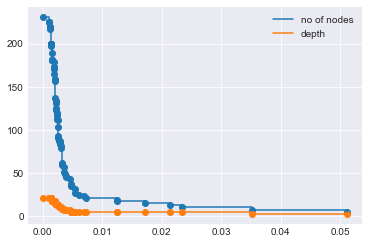

In [39]:
clfs = clfs[:-1]
ccp_alphas = ccp_alphas[:-1]
node_counts = [clf.tree_.node_count for clf in clfs]
depth = [clf.tree_.max_depth for clf in clfs]
plt.scatter(ccp_alphas,node_counts)
plt.scatter(ccp_alphas,depth)
plt.plot(ccp_alphas,node_counts,label='no of nodes',drawstyle="steps-post")
plt.plot(ccp_alphas,depth,label='depth',drawstyle="steps-post")
plt.legend()
plt.show()

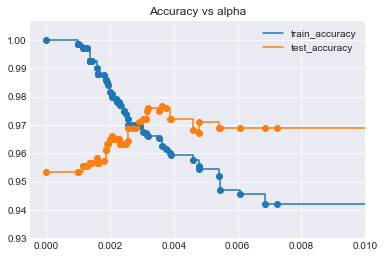

In [40]:
train_acc = []
test_acc = []
for c in clfs:
    y_train_pred = c.predict(train_x4)
    y_test_pred = c.predict(test_x4)
    train_acc.append(accuracy_score(y_train_pred, train_y))
    test_acc.append(accuracy_score(y_test_pred, test_y))

plt.scatter(ccp_alphas,train_acc)
plt.scatter(ccp_alphas,test_acc)
plt.plot(ccp_alphas,train_acc,label='train_accuracy',drawstyle="steps-post")
plt.plot(ccp_alphas,test_acc,label='test_accuracy',drawstyle="steps-post")
plt.xlim(left=-0.0005,right=0.01)
plt.ylim(bottom=0.93)
plt.legend()
plt.title('Accuracy vs alpha')
plt.show()

We can choose alpha = 0.003

In [41]:
clf_ = tree.DecisionTreeClassifier(criterion='entropy', random_state=0, ccp_alpha=0.00375)
clf_.fit(train_x4, train_y)
y_train_pred = clf_.predict(train_x4)
y_test_pred = clf_.predict(test_x4)

# Result(y_train_pred, train_y)
Result(y_test_pred, test_y)

The accuracy of the Decision Tree is 0.9767666989351403
The f1_score of the Decision Tree is 0.7499999999999999
The precision_score of the Decision Tree is 0.8372093023255814
The recall_score of the Decision Tree is 0.6792452830188679
The roc_auc_score of the Decision Tree is 0.8360512129380053
[[973  17]
 [  7  36]]


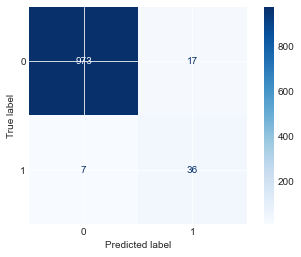

In [42]:
plot_confusion_matrix(clf_, test_x4, test_y, cmap="Blues")
plt.savefig('./Image/decision_tree_post_prun_cm.jpg', dpi=200)
plt.show()

## 特征选择

In [59]:
from sklearn.preprocessing import StandardScaler

train_x.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 17 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   account_length                 2000 non-null   int64  
 1   international_plan             2000 non-null   int64  
 2   voice_mail_plan                2000 non-null   int64  
 3   number_vmail_messages          2000 non-null   int64  
 4   total_day_minutes              2000 non-null   float64
 5   total_day_calls                2000 non-null   int64  
 6   total_day_charge               2000 non-null   float64
 7   total_eve_minutes              2000 non-null   float64
 8   total_eve_calls                2000 non-null   int64  
 9   total_eve_charge               2000 non-null   float64
 10  total_night_minutes            2000 non-null   float64
 11  total_night_calls              2000 non-null   int64  
 12  total_night_charge             2000 non-null   f

(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'account_length'),
  Text(1, 0, 'international_plan'),
  Text(2, 0, 'voice_mail_plan'),
  Text(3, 0, 'number_vmail_messages'),
  Text(4, 0, 'total_day_minutes'),
  Text(5, 0, 'total_day_calls'),
  Text(6, 0, 'total_day_charge'),
  Text(7, 0, 'total_eve_minutes')])

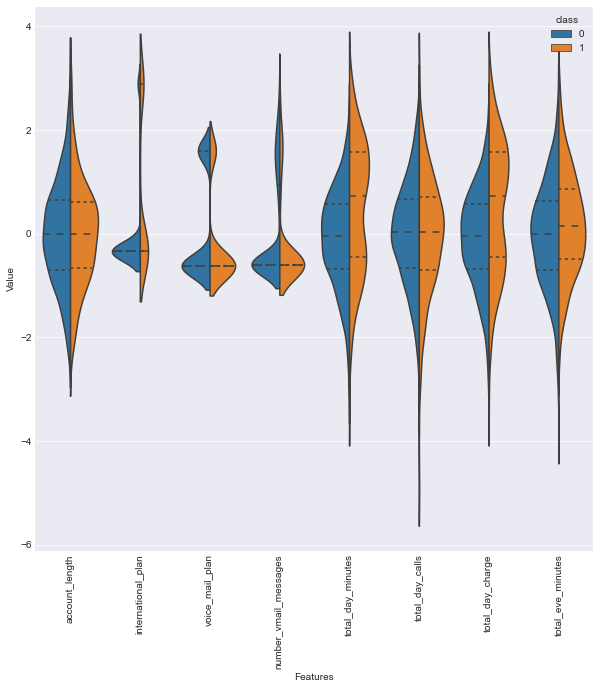

In [73]:
# Visualization

fs_y = train_y  # label-y
fs_x = train_x  # data-x

fs_x1 = (fs_x - fs_x.mean()) / fs_x.std() # Preprocessing

fs = pd.concat([fs_y, fs_x1.iloc[:, 0:8]], axis = 1) # Choosing the first 8 features
fs = pd.melt(fs, id_vars="class", var_name='Features', value_name='Value')  # Id_vars is same as label name.
plt.figure(figsize=(10, 10))
sns.violinplot(x="Features", y="Value", hue="class", data=fs, split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'account_length'),
  Text(1, 0, 'international_plan'),
  Text(2, 0, 'voice_mail_plan'),
  Text(3, 0, 'number_vmail_messages'),
  Text(4, 0, 'total_day_minutes'),
  Text(5, 0, 'total_day_calls'),
  Text(6, 0, 'total_day_charge'),
  Text(7, 0, 'total_eve_minutes')])

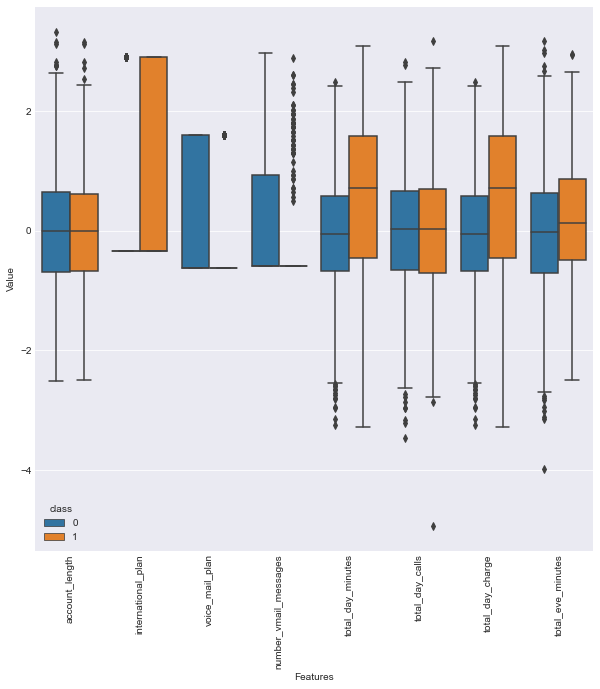

In [74]:
plt.figure(figsize=(10,10))
sns.boxplot(x="Features", y="Value", hue="class", data=fs)
plt.xticks(rotation=90)

Let 's interpret the plot above together. For example, in total_eve_minute feature, median of the Malignant and Benign looks like separated, so it can be good for classification. However, in account_length, vioce_mail_plan, number_vmail_message, total_day_charge feature median of the Malignant and Benign does not looks like separated, so it does not gives good information for classification.

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'total_eve_calls'),
  Text(1, 0, 'total_eve_charge'),
  Text(2, 0, 'total_night_minutes'),
  Text(3, 0, 'total_night_calls'),
  Text(4, 0, 'total_night_charge'),
  Text(5, 0, 'total_intl_minutes'),
  Text(6, 0, 'total_intl_calls'),
  Text(7, 0, 'total_intl_charge'),
  Text(8, 0, 'number_customer_service_calls')])

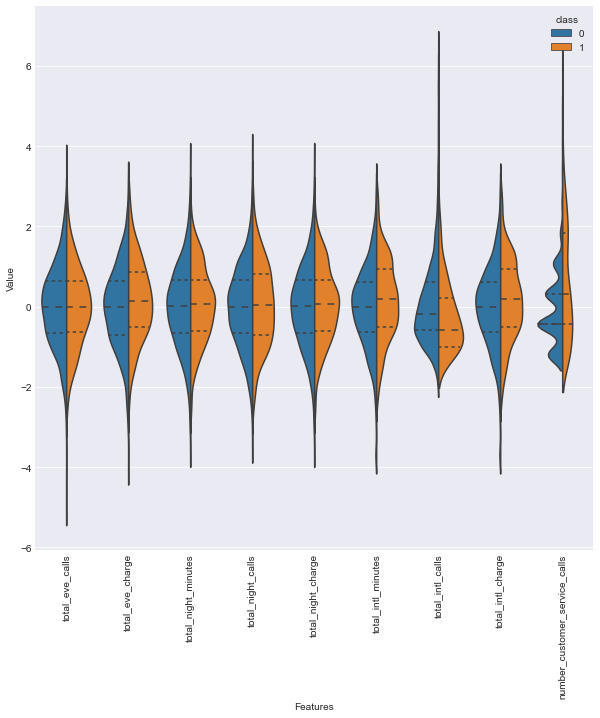

In [70]:
# Visualization

fs = pd.concat([train_y, fs_x1.iloc[:, 8:]], axis = 1)
fs = pd.melt(fs, id_vars="class", var_name='Features', value_name='Value')
plt.figure(figsize=(10, 10))
sns.violinplot(x='Features', y="Value", hue="class", data=fs, split=True, inner="quart")
plt.xticks(rotation=90)

(array([0, 1, 2, 3, 4, 5, 6, 7, 8]),
 [Text(0, 0, 'total_eve_calls'),
  Text(1, 0, 'total_eve_charge'),
  Text(2, 0, 'total_night_minutes'),
  Text(3, 0, 'total_night_calls'),
  Text(4, 0, 'total_night_charge'),
  Text(5, 0, 'total_intl_minutes'),
  Text(6, 0, 'total_intl_calls'),
  Text(7, 0, 'total_intl_charge'),
  Text(8, 0, 'number_customer_service_calls')])

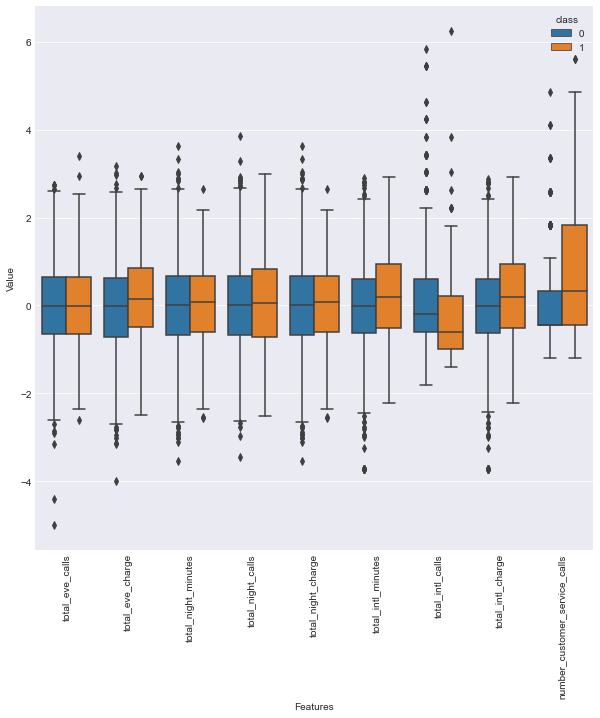

In [72]:
plt.figure(figsize=(10,10))
sns.boxplot(x="Features", y="Value", hue="class", data=fs)
plt.xticks(rotation=90)

In order to compare two features deeper, lets use joint plot. Look at this in joint plot below, it is really correlated. Pearsonr value is correlation value and 1 is the highest.

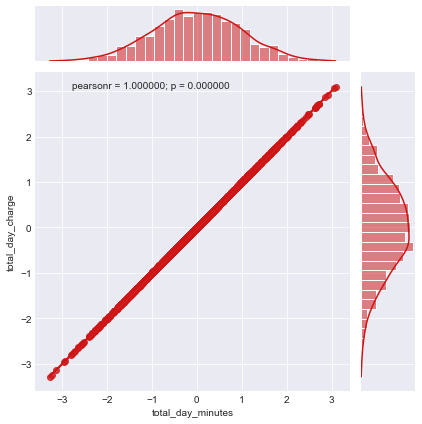

In [84]:
import scipy.stats as stats

j = sns.jointplot(fs_x1.loc[:,'total_day_minutes'], fs_x1.loc[:,'total_day_charge'], kind="reg", color="#ce1414")
r, p = stats.pearsonr(x=fs_x1.loc[:, 'total_day_minutes'], y=fs_x1.loc[:, 'total_day_charge'])
# r：相关系数[-1，1]之间
# p: p-value值
phantom, = j.ax_joint.plot([], [], linestyle="", alpha=0)
j.ax_joint.legend([phantom], ['pearsonr = {:f}; p = {:f}'.format(r,p)])
plt.show()

Above the result image, we can absolutely  true that the total_day_minutes feature and the total_day_charge feature are completely correlated.
So, we can delete the one of them. Here, we delete the total_day_minutes feature.

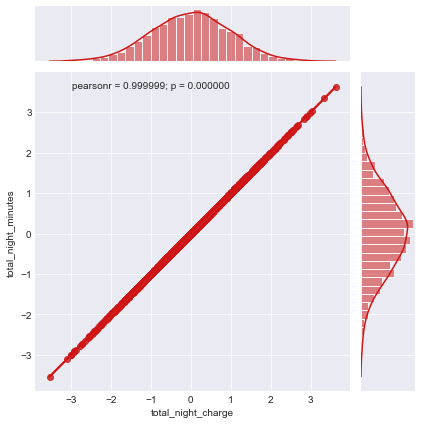

In [86]:
j = sns.jointplot(fs_x1.loc[:,'total_night_charge'], fs_x1.loc[:,'total_night_minutes'], kind="reg", color="#ce1414")
r, p = stats.pearsonr(x=fs_x1.loc[:, 'total_night_charge'], y=fs_x1.loc[:, 'total_night_minutes'])
# r：相关系数[-1，1]之间
# p: p-value值
phantom, = j.ax_joint.plot([], [], linestyle="", alpha=0)
j.ax_joint.legend([phantom], ['pearsonr = {:f}; p = {:f}'.format(r,p)])
plt.show()

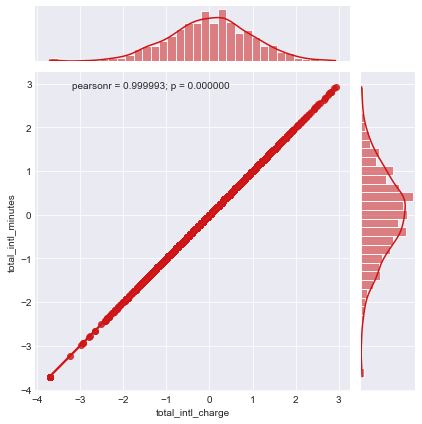

In [88]:
j = sns.jointplot(fs_x1.loc[:,'total_intl_charge'], fs_x1.loc[:,'total_intl_minutes'], kind="reg", color="#ce1414")
r, p = stats.pearsonr(x=fs_x1.loc[:, 'total_intl_charge'], y=fs_x1.loc[:, 'total_intl_minutes'])
# r：相关系数[-1，1]之间
# p: p-value值
phantom, = j.ax_joint.plot([], [], linestyle="", alpha=0)
j.ax_joint.legend([phantom], ['pearsonr = {:f}; p = {:f}'.format(r,p)])
plt.show()

### Swarm plot

(array([0, 1, 2, 3, 4, 5, 6, 7]),
 [Text(0, 0, 'account_length'),
  Text(1, 0, 'international_plan'),
  Text(2, 0, 'voice_mail_plan'),
  Text(3, 0, 'number_vmail_messages'),
  Text(4, 0, 'total_day_minutes'),
  Text(5, 0, 'total_day_calls'),
  Text(6, 0, 'total_day_charge'),
  Text(7, 0, 'total_eve_minutes')])

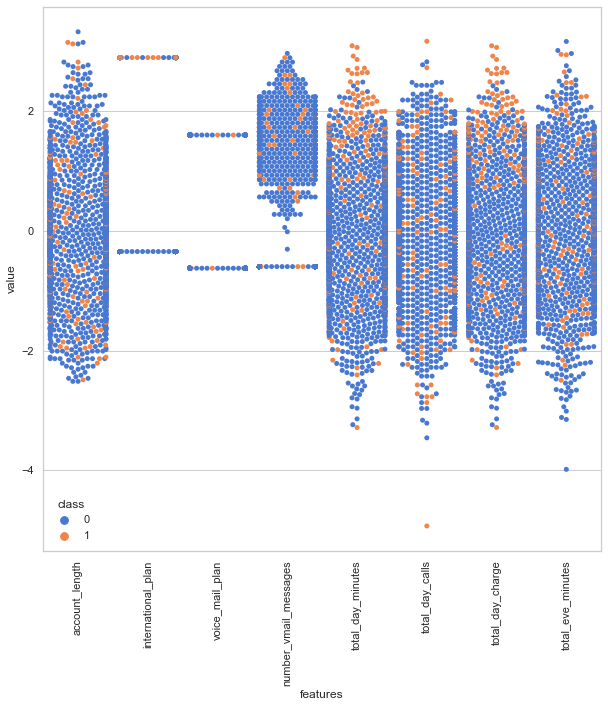

In [89]:
import time

sns.set(style="whitegrid", palette="muted")
data_dia = train_y
data = train_x
data_n_2 = (data - data.mean()) / (data.std())              # standardization
data = pd.concat([train_y, data_n_2.iloc[:,0:8]], axis=1)
data = pd.melt(data,id_vars="class",
                    var_name="features",
                    value_name='value')
plt.figure(figsize=(10,10))
tic = time.time()
sns.swarmplot(x="features", y="value", hue="class", data=data)

plt.xticks(rotation=90)

<AxesSubplot:>

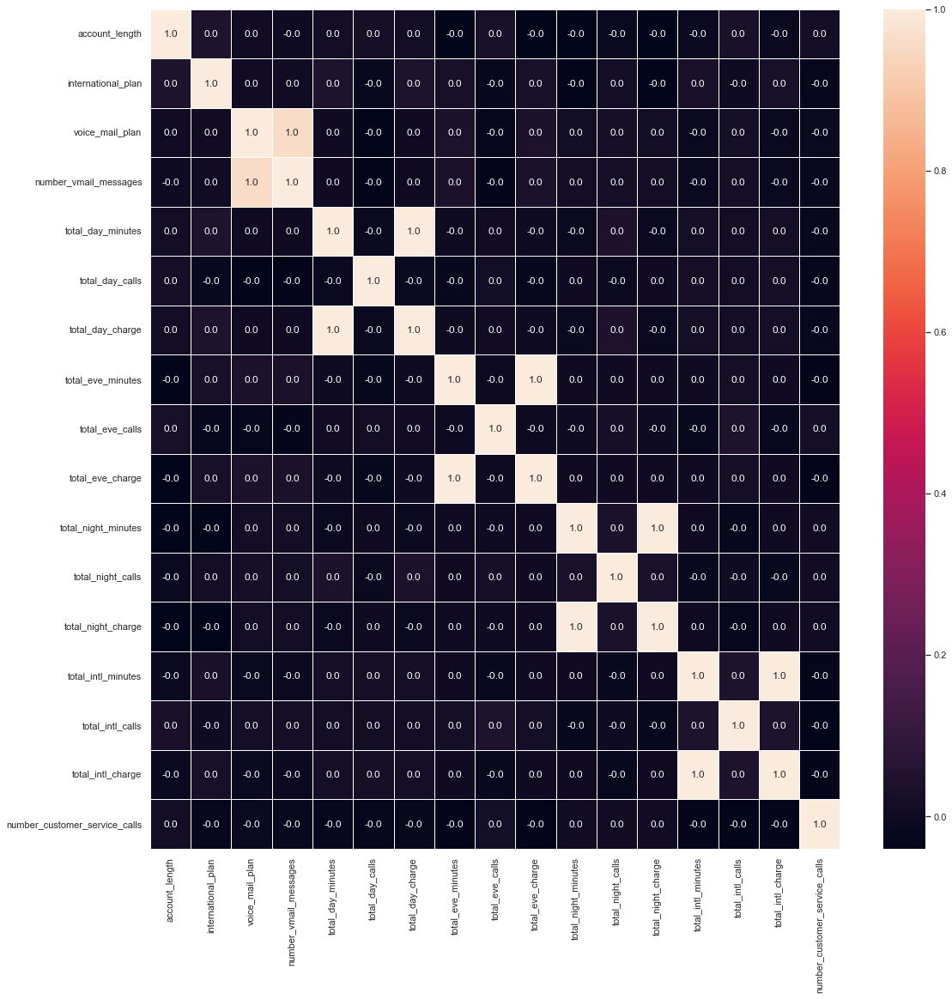

In [90]:
#correlation map
f,ax = plt.subplots(figsize=(18, 18))
sns.heatmap(train_x.corr(), annot=True, linewidths=.5, fmt= '.1f', ax=ax)

### Feature selection with correlation

In [91]:
drop_list1 = ['total_day_minutes', 'voice_mail_plan', 'total_night_minutes', 'total_eve_minutes','total_intl_charge']
x = train_x
x_1 = x.drop(drop_list1, axis=1)        # do not modify x, we will use it later
x_1.head(5)

,account_length,international_plan,number_vmail_messages,total_day_calls,total_day_charge,total_eve_calls,total_eve_charge,total_night_calls,total_night_charge,total_intl_minutes,total_intl_calls,number_customer_service_calls
0,128,0,25,110,45.07,99,16.78,91,11.01,10.0,3,1
1,84,1,0,71,50.90,88,5.26,89,8.86,6.6,7,2
2,75,1,0,113,28.34,122,12.61,121,8.41,10.1,3,3
3,118,1,0,98,37.98,101,18.75,118,9.18,6.3,6,0
4,117,0,0,97,31.37,80,29.89,90,9.71,8.7,4,1


<AxesSubplot:>

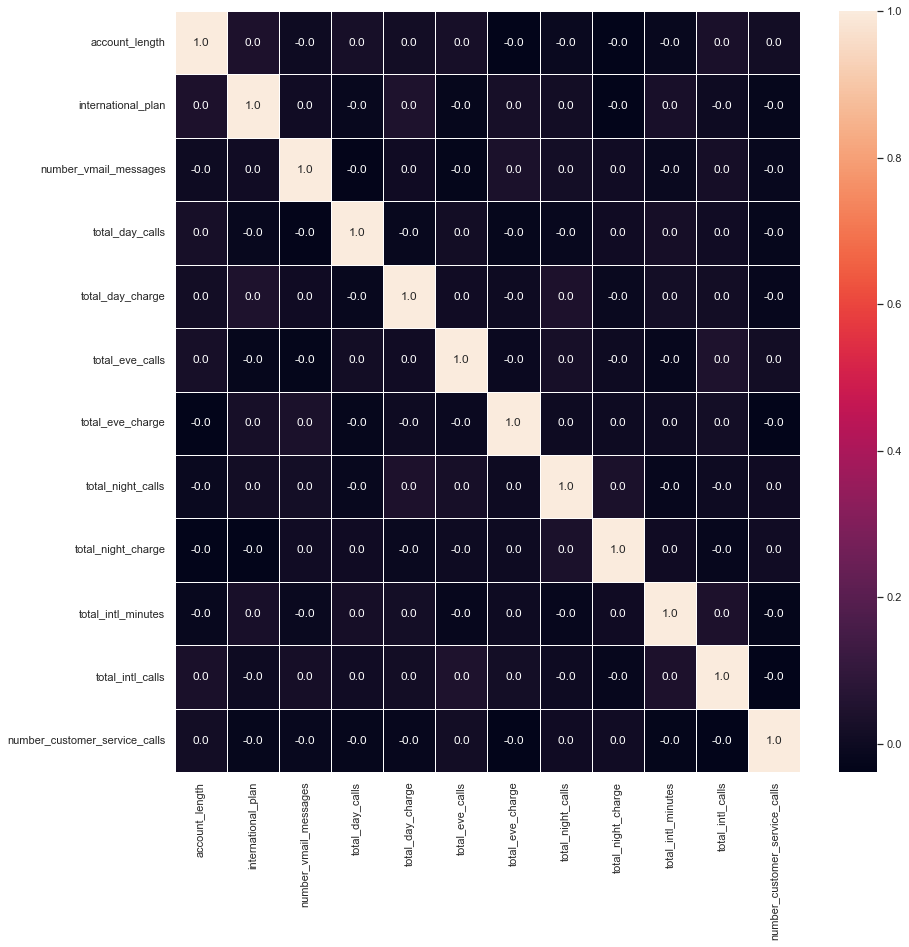

In [92]:
#correlation map
f, ax = plt.subplots(figsize=(14, 14))
sns.heatmap(x_1.corr(), annot=True, linewidths=.5, fmt= '.1f',ax=ax)

In [94]:
clf_ = tree.DecisionTreeClassifier(criterion='entropy', random_state=0, ccp_alpha=0.00375)
clf_.fit(x, train_y)
y_test_pred = clf_.predict(test_x)

# Result(y_train_pred, train_y)
Result(y_test_pred, test_y)

The accuracy of the Decision Tree is 0.9777347531461762
The f1_score of the Decision Tree is 0.7415730337078652
The precision_score of the Decision Tree is 0.7674418604651163
The recall_score of the Decision Tree is 0.717391304347826
The roc_auc_score of the Decision Tree is 0.8536297960442272
[[977  13]
 [ 10  33]]


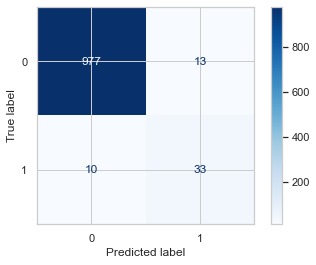

In [95]:
plot_confusion_matrix(clf_, test_x, test_y, cmap="Blues")
plt.savefig('./Image/decision_tree_fs_correlation_cm.jpg', dpi=200)
plt.show()

###  Univariate feature selection

In [14]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2
# find best scored 5 features


select_feature = SelectKBest(chi2, k=5).fit(train_x, train_y)

In [17]:
print('Score list:', select_feature.scores_)
print('Feature list:', train_x.columns)
print("Best 5 features:{0}".format(train_x.columns[:5]))

Score list: [1.50361718e-01 1.27897709e+02 8.52162815e+00 2.09885776e+02
 1.37619619e+03 2.85883015e-01 2.33940269e+02 1.21504748e+02
 9.51966983e-04 1.03241368e+01 1.24712855e+01 2.59224356e+00
 5.60879203e-01 7.87119674e+00 1.79935772e+01 2.12782263e+00
 1.00762035e+02]
Feature list: Index(['account_length', 'international_plan', 'voice_mail_plan',
       'number_vmail_messages', 'total_day_minutes', 'total_day_calls',
       'total_day_charge', 'total_eve_minutes', 'total_eve_calls',
       'total_eve_charge', 'total_night_minutes', 'total_night_calls',
       'total_night_charge', 'total_intl_minutes', 'total_intl_calls',
       'total_intl_charge', 'number_customer_service_calls'],
      dtype='object')
Best 5 features:Index(['account_length', 'international_plan', 'voice_mail_plan',
       'number_vmail_messages', 'total_day_minutes'],
      dtype='object')


In [21]:
x_train_2 = select_feature.transform(train_x)
x_test_2 = select_feature.transform(test_x)

clf_rf_2 = tree.DecisionTreeClassifier(criterion='entropy', random_state=0, ccp_alpha=0.00375)
clr_rf_2 = clf_rf_2.fit(x_train_2, train_y)

y_test_pred = clf_rf_2.predict(x_test_2)
Result(y_test_pred, test_y)

The accuracy of the Decision Tree is 0.9651500484027106
The f1_score of the Decision Tree is 0.5
The precision_score of the Decision Tree is 0.4186046511627907
The recall_score of the Decision Tree is 0.6206896551724138
The roc_auc_score of the Decision Tree is 0.7978946283830196
[[979  11]
 [ 25  18]]


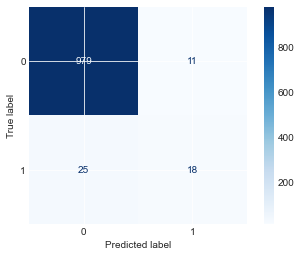

In [23]:
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt

plot_confusion_matrix(clf_rf_2, x_test_2, test_y, cmap="Blues")
plt.savefig('./Image/decision_tree_fs_Univariate_cm.jpg', dpi=200)
plt.show()

###  Recursive feature elimination (RFE)

In [37]:
from sklearn.feature_selection import RFE
# Create the RFE object and rank each pixel

clf_rf_3 = tree.DecisionTreeClassifier(criterion='entropy', random_state=0, ccp_alpha=0.00375)
rfe = RFE(estimator=clf_rf_3, n_features_to_select=15, step=1)
rfe = rfe.fit(train_x, train_y)

In [40]:
print('Chosen best 15 feature by rfe:', train_x.columns[rfe.support_])

Chosen best 15 feature by rfe: Index(['international_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_calls', 'total_day_charge', 'total_eve_minutes',
       'total_eve_calls', 'total_eve_charge', 'total_night_minutes',
       'total_night_calls', 'total_night_charge', 'total_intl_minutes',
       'total_intl_calls', 'total_intl_charge',
       'number_customer_service_calls'],
      dtype='object')


In [39]:
x_train_3 = train_x[train_x.columns[rfe.support_]]
x_test_3 = test_x[train_x.columns[rfe.support_]]

clf_rf_3 = tree.DecisionTreeClassifier(criterion='entropy', random_state=0, ccp_alpha=0.00375)
clr_rf_3 = clf_rf_3.fit(x_train_3, train_y)

y_test_pred = clf_rf_3.predict(x_test_3)
Result(y_test_pred, test_y)

The accuracy of the Decision Tree is 0.9777347531461762
The f1_score of the Decision Tree is 0.7415730337078652
The precision_score of the Decision Tree is 0.7674418604651163
The recall_score of the Decision Tree is 0.717391304347826
The roc_auc_score of the Decision Tree is 0.8536297960442272
[[977  13]
 [ 10  33]]


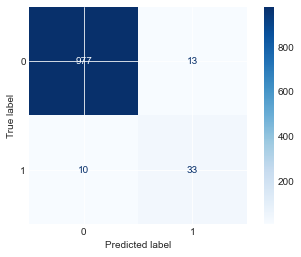

In [41]:
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt

plot_confusion_matrix(clf_rf_3, x_test_3, test_y, cmap="Blues")
plt.savefig('./Image/decision_tree_fs_RFE_cm.jpg', dpi=200)
plt.show()

###  Recursive feature elimination with cross validation

In [42]:
from sklearn.feature_selection import RFECV

rfecv = RFECV(estimator=clf_rf_3, step=1, cv=5,scoring='accuracy')   #5-fold cross-validation
rfecv = rfecv.fit(train_x, train_y)

print('Optimal number of features :', rfecv.n_features_)
print('Best features :', train_x.columns[rfecv.support_])

Optimal number of features : 12
Best features : Index(['international_plan', 'number_vmail_messages', 'total_day_minutes',
       'total_day_charge', 'total_eve_minutes', 'total_eve_calls',
       'total_eve_charge', 'total_night_minutes', 'total_night_charge',
       'total_intl_minutes', 'total_intl_calls',
       'number_customer_service_calls'],
      dtype='object')


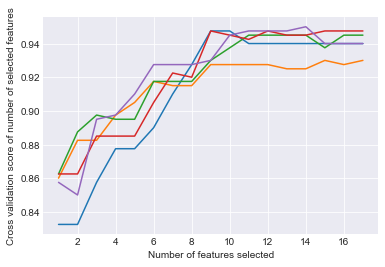

In [46]:
# Plot number of features VS. cross-validation scores
import matplotlib.pyplot as plt
plt.figure()
plt.xlabel("Number of features selected")
plt.ylabel("Cross validation score of number of selected features")
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
plt.show()

### Feature Extraction with PCA

Text(0, 0.5, 'explained_variance_ratio_')

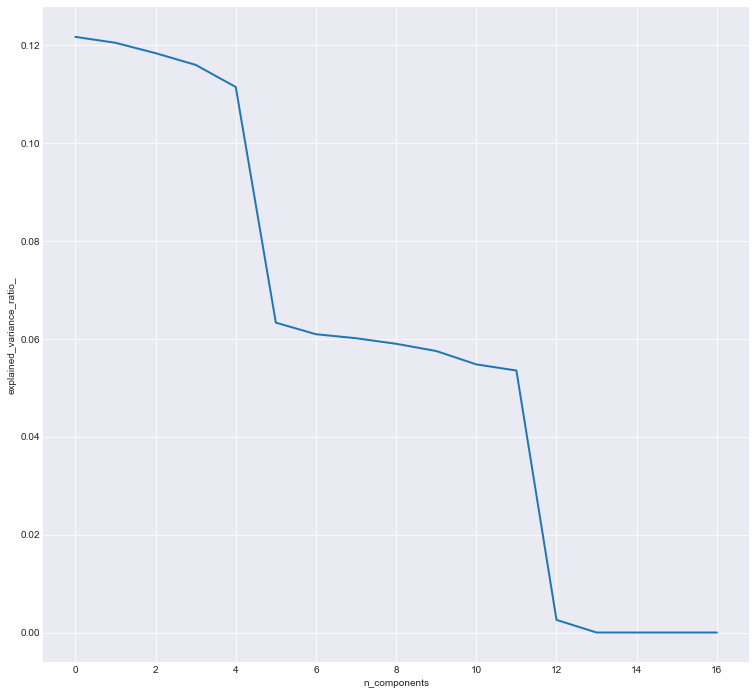

In [50]:
from sklearn.decomposition import PCA
pca = PCA()
pca.fit(train_x2) # train_x2 have been StandardScaler

plt.figure(1, figsize=(14, 13))
plt.clf()
plt.axes([.2, .2, .7, .7])
plt.plot(pca.explained_variance_ratio_, linewidth=2)
plt.axis('tight')
plt.xlabel('n_components')
plt.ylabel('explained_variance_ratio_')

In [52]:
from sklearn.decomposition import PCA

x_embedded_1 = PCA(n_components=3).fit_transform(train_x2)
x_embedded_2 = PCA(n_components=3).fit_transform(test_x2)


clr_rf_3 = clf_rf_3.fit(x_embedded_1, train_y)

y_test_pred = clf_rf_3.predict(x_embedded_2)
Result(y_test_pred, test_y)

The accuracy of the Decision Tree is 0.9554695062923524
The f1_score of the Decision Tree is 0.0
The precision_score of the Decision Tree is 0.0
The recall_score of the Decision Tree is 0.0
The roc_auc_score of the Decision Tree is 0.479126213592233
[[987   3]
 [ 43   0]]


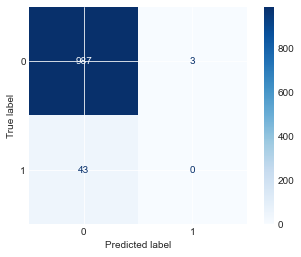

In [53]:
plot_confusion_matrix(clf_rf_3, x_embedded_2, test_y, cmap="Blues")
plt.savefig('./Image/decision_tree_fs_PCA_cm.jpg', dpi=200)
plt.show()